In [1]:
### Set CUDA device
import os

os.environ['CUDA_VISIBLE_DEVICES'] = '6'

In [19]:

from typing import (
    Dict, 
    Union, 
    List,
    Callable,
    Tuple,
    Optional,
    Type
)
from scipy.stats import normaltest
from scipy.stats.mstats import ttest_ind
from copy import deepcopy
import numpy as np
import pandas as pd
import torch
from torch import Tensor, nn
from torch.utils.data import Dataset, DataLoader, default_collate
import torch.nn.functional as F
import sys
from omegaconf import OmegaConf
from sklearn.metrics import auc
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List, Dict
from torchvision.transforms import GaussianBlur
from torchmetrics.functional.classification import dice
from sklearn.covariance import LedoitWolf
from torchmetrics.classification import BinaryPrecisionRecallCurve
from torch.utils.data._utils.collate import collate
## Augmentations
from batchgenerators.transforms.noise_transforms import augment_gaussian_blur


sys.path.append('../')
from data_utils import get_eval_data
from model.unet import get_unet
from utils import  epoch_average, UMapGenerator
from model.mahalanobis_adatper import (
    get_pooling_mahalanobis_detector, 
    get_batchnorm_mahalanobis_detector
)
from model.wrapper import PoolingMahalanobisWrapper, BatchNormMahalanobisWrapper

# from losses import (
#     DiceScoreCalgary, 
#     DiceScoreMMS
# )

In [3]:
### Load basic config
cfg = OmegaConf.load('../configs/basic_config_venusberg.yaml')
OmegaConf.update(cfg, 'run.iteration', 0)

In [4]:
### Set dataset, either brain or heart
DATA_KEY = 'heart'
OmegaConf.update(cfg, 'run.data_key', DATA_KEY)


### get model
# available models:
#     - default-8
#     - default-16
#     - monai-8-4-4
#     - monai-16-4-4
#     - monai-16-4-8
#     - monai-32-4-4
#     - monai-64-4-4
#     - swinunetr


unet_name = 'default-8'
postfix = '' # '_no-blurring'
args = unet_name.split('-')
cfg.unet[DATA_KEY].pre = unet_name + postfix
cfg.unet[DATA_KEY].arch = args[0]
cfg.unet[DATA_KEY].n_filters_init = int(args[1])

if args[0] == 'monai':
    cfg.unet[DATA_KEY].depth = int(args[2])
    cfg.unet[DATA_KEY].num_res_units = int(args[3])


unet, state_dict = get_unet(
    cfg,
    update_cfg_with_swivels=False,
    return_state_dict=True)
unet.load_state_dict(state_dict)
_ = unet.cuda()

In [5]:
# Set debug mode for only a small fraction of the datasets. Speeds up this cell by alot
cfg.debug = False

# update config with default values
OmegaConf.update(
    cfg, 
    'eval',
    OmegaConf.load('../configs/eval/unet_config.yaml')
)

# Wether and how you want to subset in case of Brain data. WARNING:
# After subsetting the eval below will not work with surface
# Dice anymore, because volumes are fragmented. 
APPLY_SUBSETTING = True
OmegaConf.update(cfg, 'eval.data.subset.apply', APPLY_SUBSETTING)
subset_params = {
    'n_cases': 256,  # selects at most so many cases
    'fraction': 0.1, # selects from the 10% worst cases w.r.t to a model
}
OmegaConf.update(
    cfg, 
    'eval.data.subset.params', 
    OmegaConf.create(subset_params)
)

if cfg.eval.data.subset.apply:
    subset_dict = OmegaConf.to_container(
        cfg.eval.data.subset.params, 
        resolve=True, 
        throw_on_missing=True
    )
    subset_dict['unet'] = unet
else:
    subset_dict = None

### select the datasets within the domain
# get training data
cfg.eval.data.training = True
# get validation data
cfg.eval.data.validation = True
# get testing data
# Options for Brain are any subset of [1, 2, 3, 4, 5] or 'all' 
# Options for Heart are any subset of ['A', 'B', 'C', 'D'] or 'all'
cfg.eval.data.testing = ['B'] #, 'B'] #'all' #['A'] #


data = get_eval_data(
    train_set=cfg.eval.data.training,
    val_set=cfg.eval.data.validation,
    test_sets=cfg.eval.data.testing,    
    cfg=cfg,
    subset_dict=subset_dict
)

print(f'\nAvailable datasets are: {list(data.keys())}')

loading dataset
loading all case properties


loading dataset
loading all case properties
loading dataset
loading all case properties

Available datasets are: ['train', 'val', 'B']


In [6]:
dataloader = DataLoader(
    data['train'],
    batch_size=32,
    shuffle=False,
    num_workers=4,
    drop_last=False,
)

In [7]:
def filter_names_by_group(names, groups):
    # Create a dictionary to hold the names categorized by group
    grouped_names = {}

    # Loop over each name in the list
    for name in names:
        # Split the name on the dot and take the first part as the group
        group_key = name.split('.')[0]

        # If the group_key is one of the requested groups, add the name to the corresponding list in the dictionary
        if group_key in groups:
            if group_key not in grouped_names:
                grouped_names[group_key] = []
            grouped_names[group_key].append(name)

    # Prepare the result list by aggregating all names from requested groups
    result_names = []
    for group in groups:
        if group in grouped_names:
            result_names.extend(grouped_names[group])

    return result_names




### Brainstorming

Question: How accurate is the distribution we fit?

- Plot histogram per pixel for id and ood
    - get activation maps for all images
    - whiten the data per voxel
    - plot histogram
    - overlay standard gaussian
    - select some pixels and visualize to see wether there is variation

In [8]:
class ActivationCache(nn.Module):
    """Dummy Adapter to store activations for a given layer per batch.

    Attach this adapter via hooks (forward, preforward) to a layer in a 
    model by name of that layer. After each forward pass, the input means
    are stored in the attribute `input_means` of this adapter.

    Args:
        swivel (str): Name of the layer in the model to attach to.
        device (str, optional): Device to store the input means on. Defaults to 'cuda:0'.
    """
    def __init__(
        self,
        swivel: str,
        device: str  = 'cuda:0'
    ):
        super().__init__()
        # init args
        self.swivel = swivel
        self.device = device
        self.to(device)

    ### public methods ###

    def forward(
        self, 
        x: Tensor
    ) -> Tensor:
        self.act = x.detach().cpu()
        return x
    

class ActivationCacheWrapper(nn.Module):
    """Wrapper for a model and a list of adapters.

    Each adapter is attached to a layer in the model via hooks. The layers
    are defined in the adapters themselves. 
    """
    def __init__(
        self,
        model: nn.Module,
        adapters: nn.ModuleList,
        copy: bool = True,
    ):
        super().__init__()
        self.model = deepcopy(model) if copy else model
        self.adapters = adapters
        self.adapter_handles = {}
        self.model.eval()

        self.acts = {}


    def hook_adapters(
        self,
    ) -> None:
        # iterate over all adapters. You can use multiple simultaneously
        for adapter in self.adapters:
            # get the layer name of the layer we want to attach to
            swivel = adapter.swivel
            # get the actual layer from the model
            layer  = self.model.get_submodule(swivel)
            # get the hook function for this layer/adapter
            hook = self._get_hook(adapter, swivel)
            # attach the hook to the layer and save handle to remove hook 
            # if needed 
            self.adapter_handles[
                swivel
            ] = layer.register_forward_pre_hook(hook)


    def _get_hook(
        self,
        adapter: nn.Module,
        swivel: str
    ) -> Callable:
        # registering hooks requires a function that takes the module and the input,
        # nothing more. To access the adapter anyways, we create the hook in a 
        # scope where the adapter is accessible, i.e. in another function.
        def hook_fn(
            module: nn.Module, 
            x: Tuple[Tensor]
        ) -> Tensor:
            # hook signature given by pytorch:
            # hook(module, input) -> None or modified input

            # pass through the adapter
            out = adapter(x[0])
            # save the results from this hook in a dict by layer name
            self.acts[swivel] = adapter.act

            return out
        
        return hook_fn


    def forward(
        self, 
        x: Tensor
    ) -> Tensor:
        # hijack the forward pass of your actual model
        return self.model(x)
    

 # type: ignore

def collate_fn(batch, *, collate_fn_map: Optional[Dict[Union[Type, Tuple[Type, ...]], Callable]] = None):
    elem = batch[0]
    out = None
    if elem.is_nested:
        raise RuntimeError(
            "Batches of nested tensors are not currently supported by the default collate_fn; "
            "please provide a custom collate_fn to handle them appropriately."
        )
    if elem.layout in {torch.sparse_coo, torch.sparse_csr, torch.sparse_bsr, torch.sparse_csc, torch.sparse_bsc}:
        raise RuntimeError(
            "Batches of sparse tensors are not currently supported by the default collate_fn; "
            "please provide a custom collate_fn to handle them appropriately."
        )
    if torch.utils.data.get_worker_info() is not None:
        # If we're in a background process, concatenate directly into a
        # shared memory tensor to avoid an extra copy
        numel = sum(x.numel() for x in batch)
        storage = elem._typed_storage()._new_shared(numel, device=elem.device)
        out = elem.new(storage).resize_(len(batch), *list(elem.size()))
    return torch.cat(batch, 0, out=out)


default_collate_fn_map: Dict[Union[Type, Tuple[Type, ...]], Callable] = {torch.Tensor: collate_fn}


In [9]:
swivels = [layer[0] for layer in unet.named_modules() if 'bn' in layer[0]]
swivels

['init_path.2.conv_path.0.bn',
 'init_path.2.conv_path.1.bn',
 'init_path.3.conv_path.0.bn',
 'init_path.3.conv_path.1.bn',
 'init_path.4.conv_path.0.bn',
 'init_path.4.conv_path.1.bn',
 'down1.3.conv_path.0.bn',
 'down1.3.conv_path.1.bn',
 'down1.4.conv_path.0.bn',
 'down1.4.conv_path.1.bn',
 'down1.5.conv_path.0.bn',
 'down1.5.conv_path.1.bn',
 'down2.3.conv_path.0.bn',
 'down2.3.conv_path.1.bn',
 'down2.4.conv_path.0.bn',
 'down2.4.conv_path.1.bn',
 'down2.5.conv_path.0.bn',
 'down2.5.conv_path.1.bn',
 'down3.4.conv_path.0.bn',
 'down3.4.conv_path.1.bn',
 'down3.5.conv_path.0.bn',
 'down3.5.conv_path.1.bn',
 'down3.6.conv_path.0.bn',
 'down3.6.conv_path.1.bn',
 'up3.0.conv_path.0.bn',
 'up3.0.conv_path.1.bn',
 'up3.1.conv_path.0.bn',
 'up3.1.conv_path.1.bn',
 'up3.2.conv_path.0.bn',
 'up3.2.conv_path.1.bn',
 'up2.0.conv_path.0.bn',
 'up2.0.conv_path.1.bn',
 'up2.1.conv_path.0.bn',
 'up2.1.conv_path.1.bn',
 'up2.2.conv_path.0.bn',
 'up2.2.conv_path.1.bn',
 'up1.0.conv_path.0.bn',
 'u

/tmp/ipykernel_1730734/1112617612.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(16, 4, figsize=(20, 50))


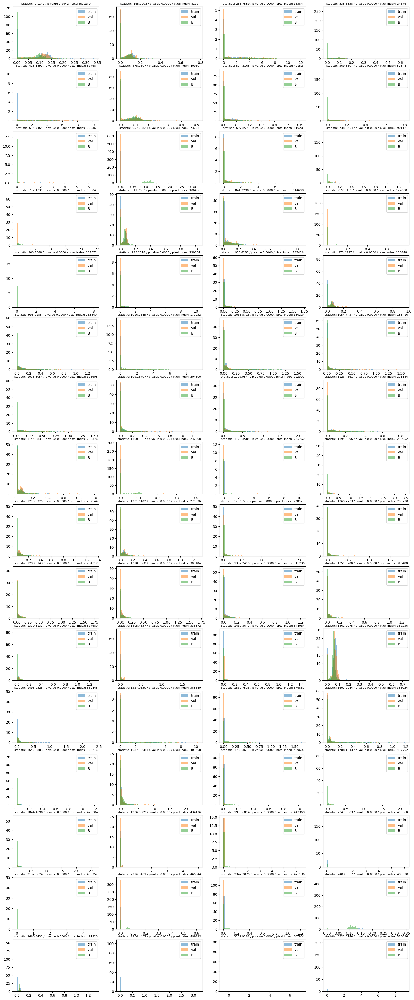

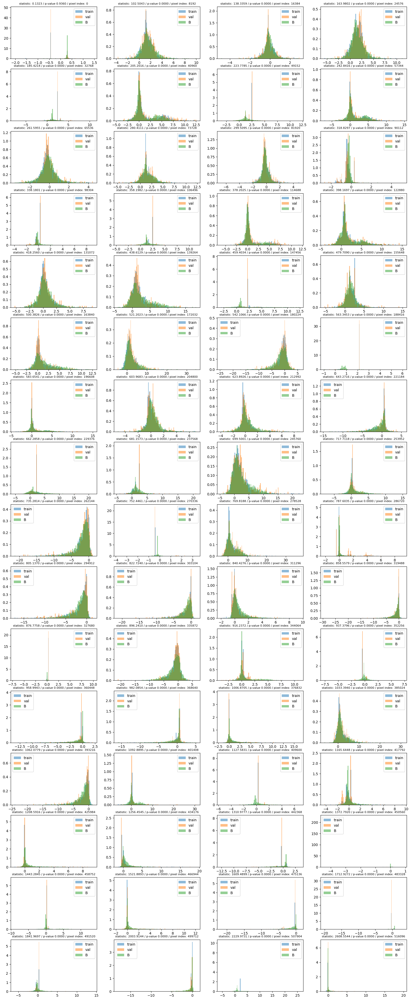

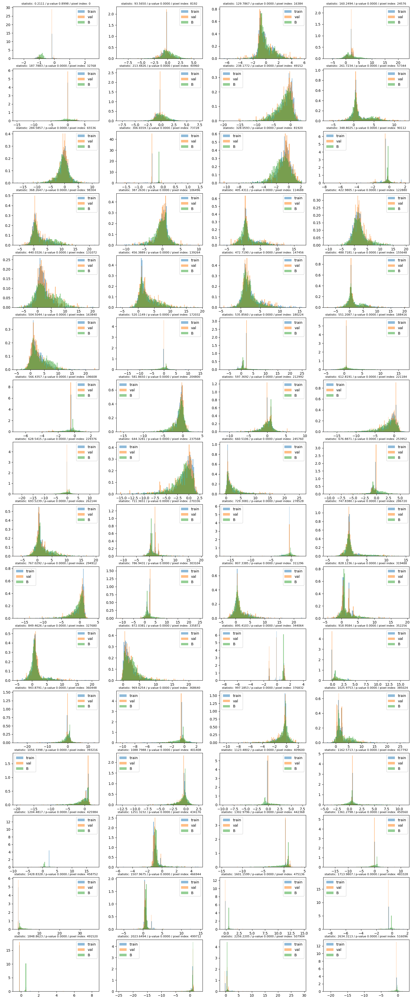

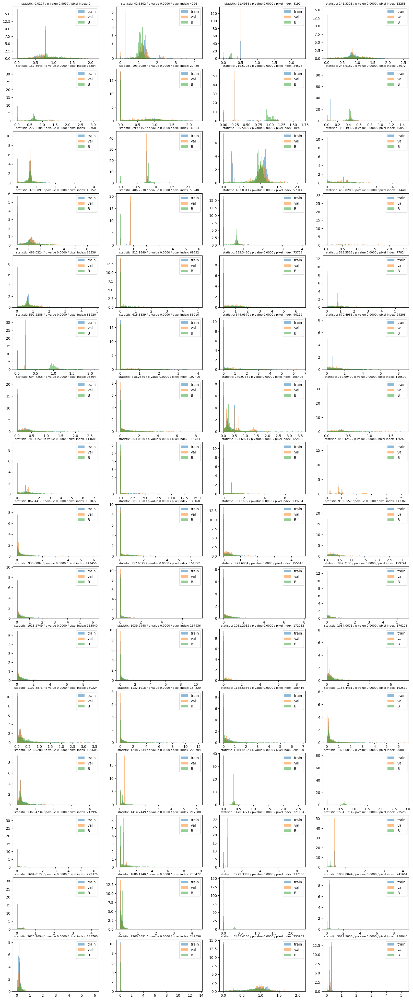

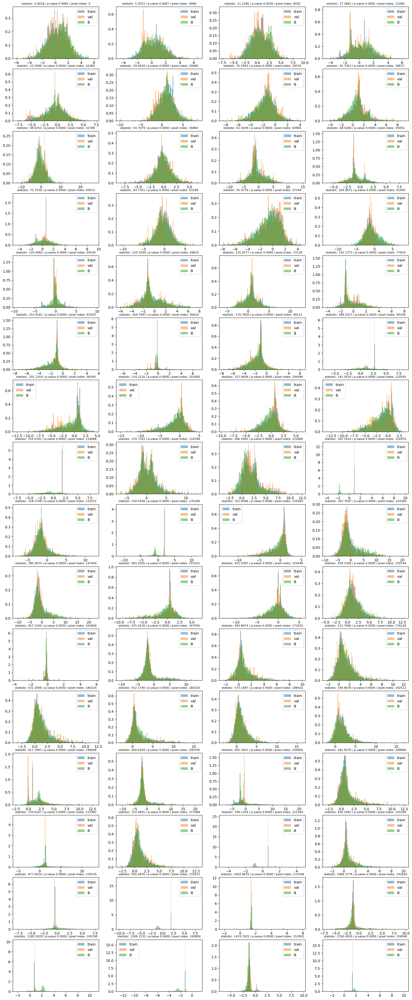

...

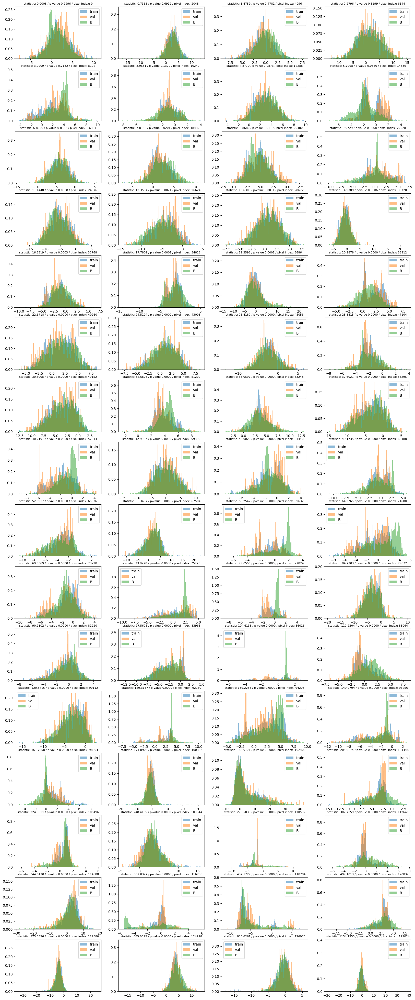

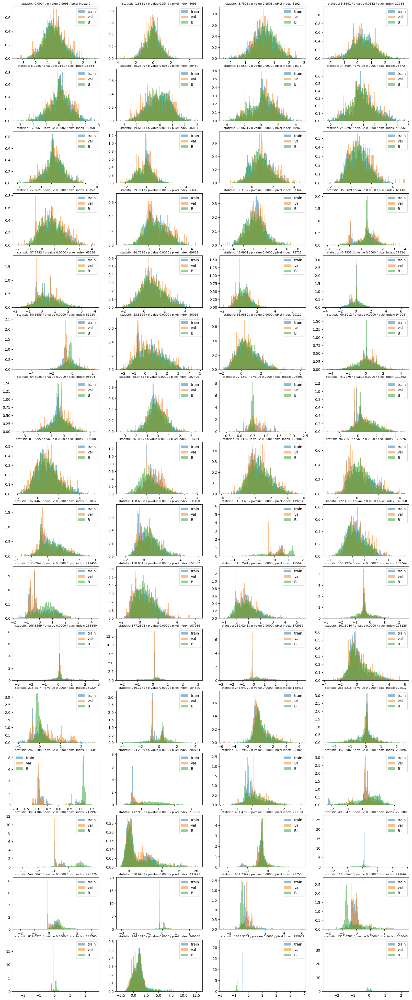

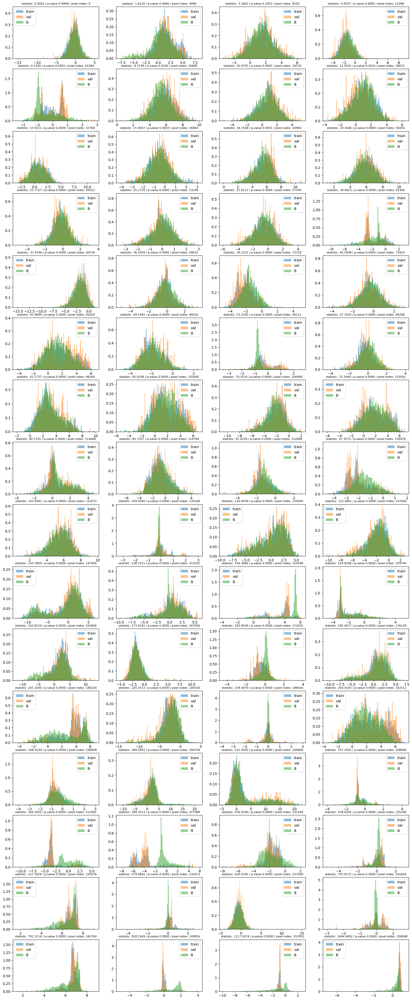

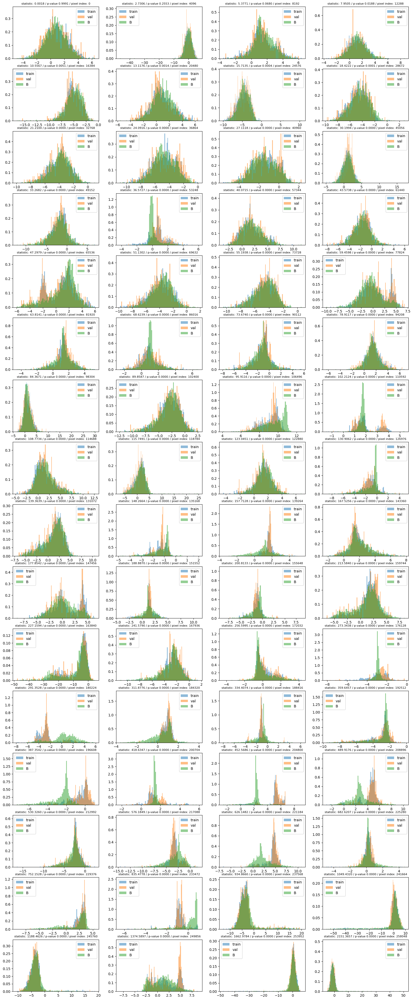

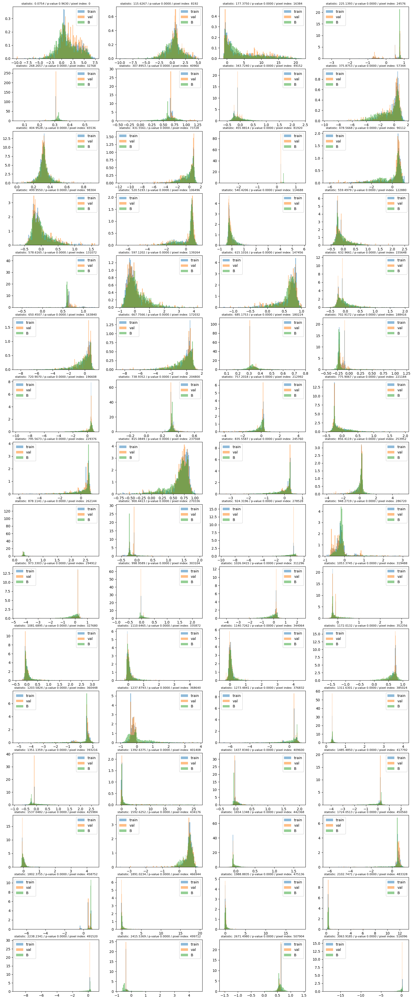

In [10]:
train_loader = DataLoader(
    data['train'],
    batch_size=32,
    shuffle=False,
    num_workers=1,
    drop_last=True,
)

# swivels = [
#     'up3.0.conv_path.0.bn',
# ]

swivels = [layer[0] for layer in unet.named_modules() if '0.bn' in layer[0]]



for swivel in swivels:
    all_acts = {}
    fig, axes = plt.subplots(16, 4, figsize=(20, 50))
    for domain in data:
        loader = DataLoader(
            data[domain],
            batch_size=32,
            shuffle=False,
            num_workers=1,
            drop_last=True,
        )
        acts = []

        cache = ActivationCacheWrapper(
            model=unet,
            adapters=nn.ModuleList([ActivationCache(swivel)]),
            copy=True
        )
        cache.hook_adapters()

        for i, batch in enumerate(loader):
            _ = cache(batch['input'].cuda())
            acts.append(deepcopy(cache.acts))
        X = collate(acts, collate_fn_map=default_collate_fn_map)[swivel].flatten(1,3).numpy()

        if domain == 'train':
            statistic, p_value = normaltest(X, axis=0)
            # sort in ascending order
            idxs = np.argsort(statistic)
            # subset the data for feasible plotting
            step_size = X.shape[1] // 64
        X_subset = X[:, idxs[::step_size]]

    # fig, axes = plt.subplots(16, 4, figsize=(20, 50))
        for i, ax in enumerate(axes.flatten()):
            # if domain == 'train':
            #     alpha = 1
            # else:
            #     alpha = 0.3

            ax.hist(
                X_subset[:, i], 
                bins=100, 
                label=f'{domain}', 
                alpha=0.5,
                density=True
            )
            ax.legend()
            stat = f'statistic: {statistic[idxs[::step_size][i]]:.4f} / ' \
                f'p-value {p_value[idxs[::step_size][i]]:.4f} / ' \
                f'pixel index: {i * step_size}'
            ax.set_title(stat, fontsize=8)

    fig.savefig(f'figures/activations/act-hist_{swivel}.png', bbox_inches='tight')

    # print(acts[0]['up3.0.conv_path.0.bn'].sum())
    
    # if i == 1:
    #     break

# acts = torch.cat([act['up3.0.conv_path.0.bn'] for act in acts])
# acts = default_collate(acts)


/tmp/ipykernel_4093772/394652793.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(16, 4, figsize=(20, 50))


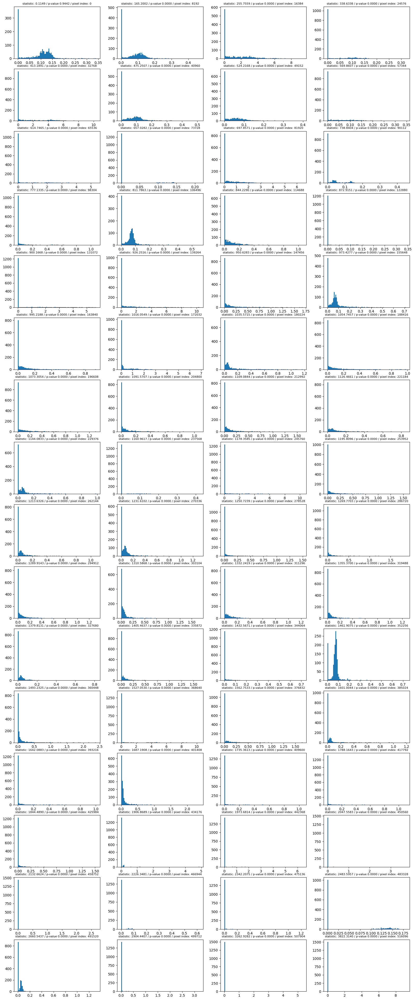

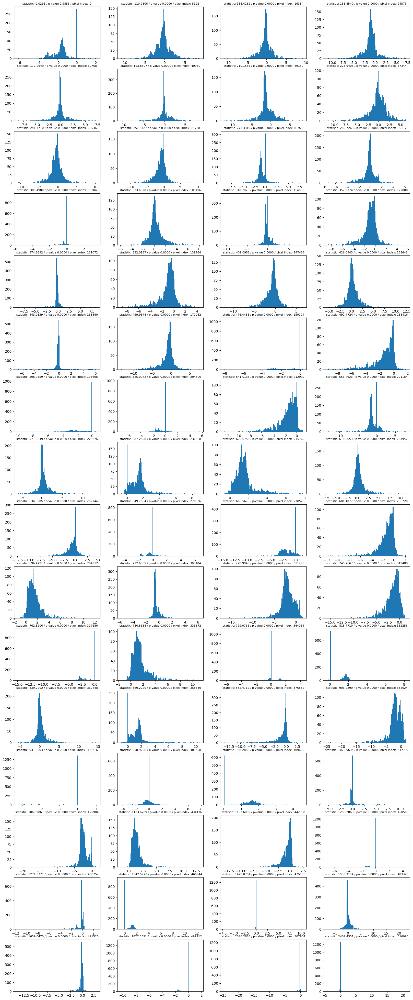

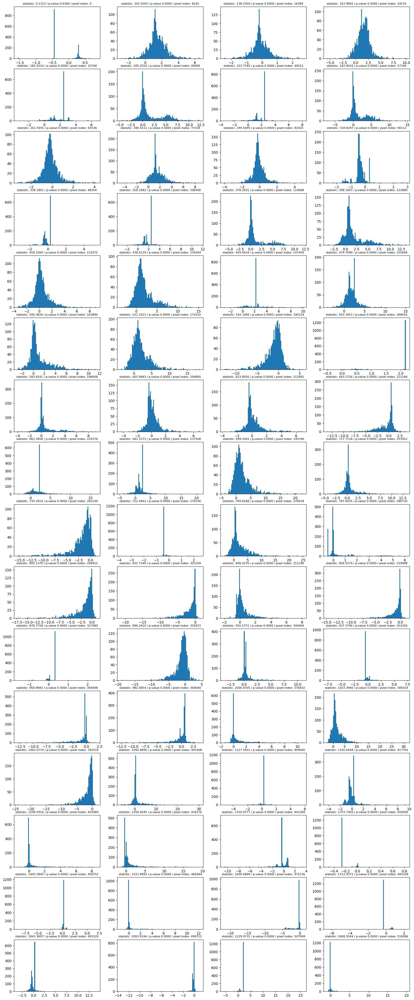

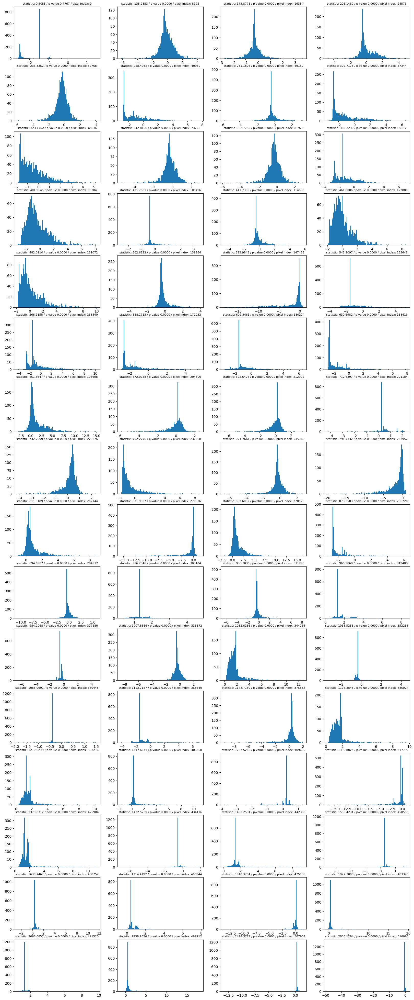

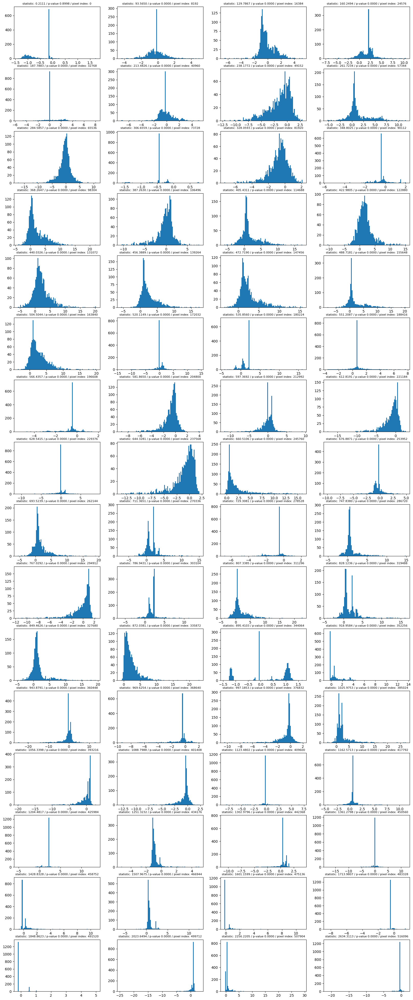

...

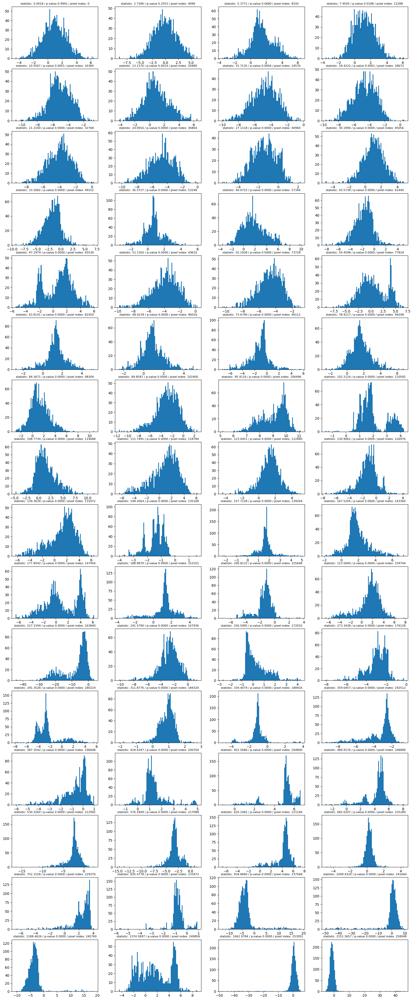

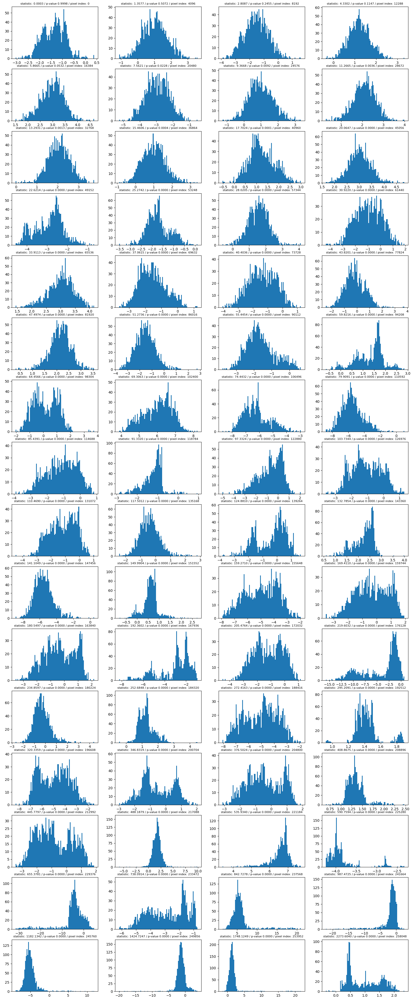

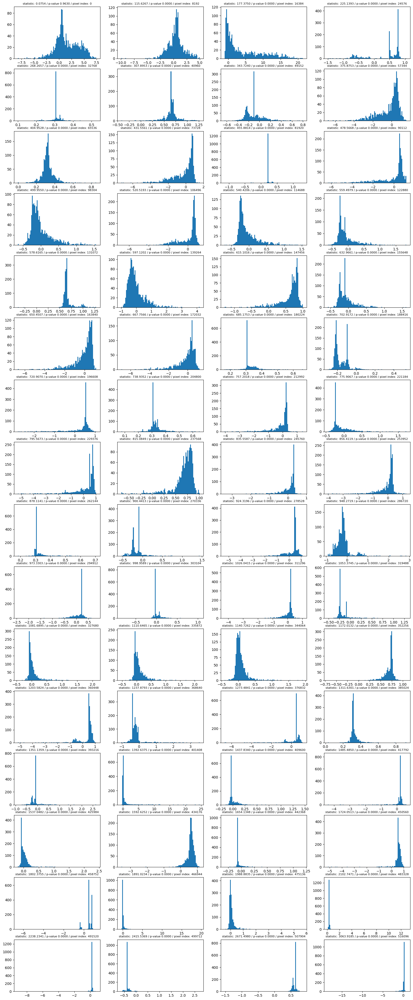

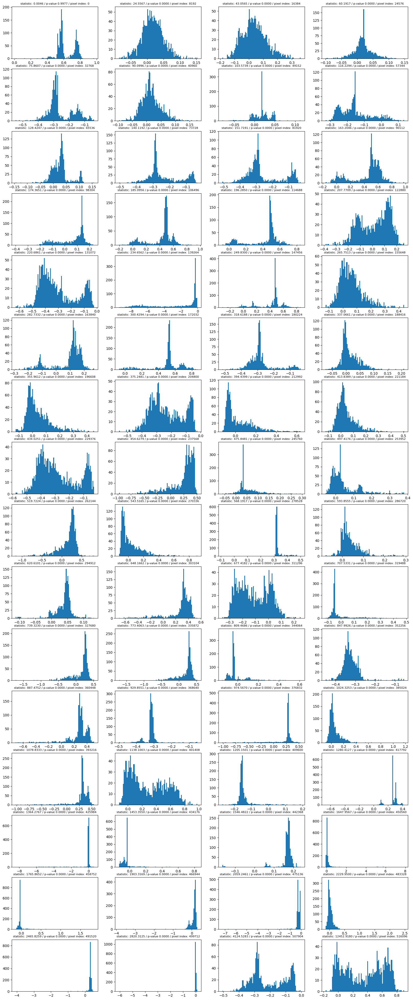

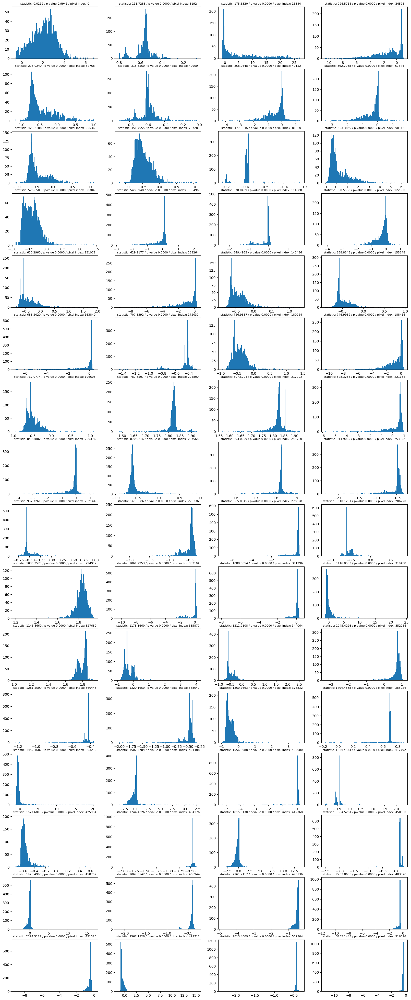

In [72]:
for layer in acts.keys():
    X = acts[layer].flatten(1,3).numpy()
    statistic, p_value = normaltest(X, axis=0)

    # sort in ascending order
    idxs = np.argsort(statistic)
    # subset the data for feasible plotting
    step_size = X.shape[1] // 64
    X_subset = X[:, idxs[::step_size]]

    fig, axes = plt.subplots(16, 4, figsize=(20, 50))
    for i, ax in enumerate(axes.flatten()):
        ax.hist(X_subset[:, i], bins=100)
        stat = f'statistic: {statistic[idxs[::step_size][i]]:.4f} / ' \
            f'p-value {p_value[idxs[::step_size][i]]:.4f} / ' \
            f'pixel index: {i * step_size}'
        ax.set_title(stat, fontsize=8)

    fig.savefig(f'figures/activations/act-hist_{layer}.png', bbox_inches='tight')


In [14]:
swivel = 'up3'
act_dict = {}
for domain in data:
    loader = DataLoader(
        data[domain],
        batch_size=32,
        shuffle=False,
        num_workers=1,
        drop_last=True,
    )
    cache = ActivationCacheWrapper(
        model=unet,
        adapters=nn.ModuleList([ActivationCache(swivel)]),
        copy=True
    )
    cache.hook_adapters()
    acts = []
    for i, batch in enumerate(loader):
        _ = cache(batch['input'].cuda())
        acts.append(deepcopy(cache.acts))
    act_dict[domain] = collate(acts, collate_fn_map=default_collate_fn_map)[swivel].flatten(1,3).numpy()


In [21]:
statistic, p_value = ttest_ind(act_dict['train'], act_dict['B'])
idxs = np.argsort(np.abs(statistic))

In [24]:
idxs = np.argsort(np.abs(statistic))

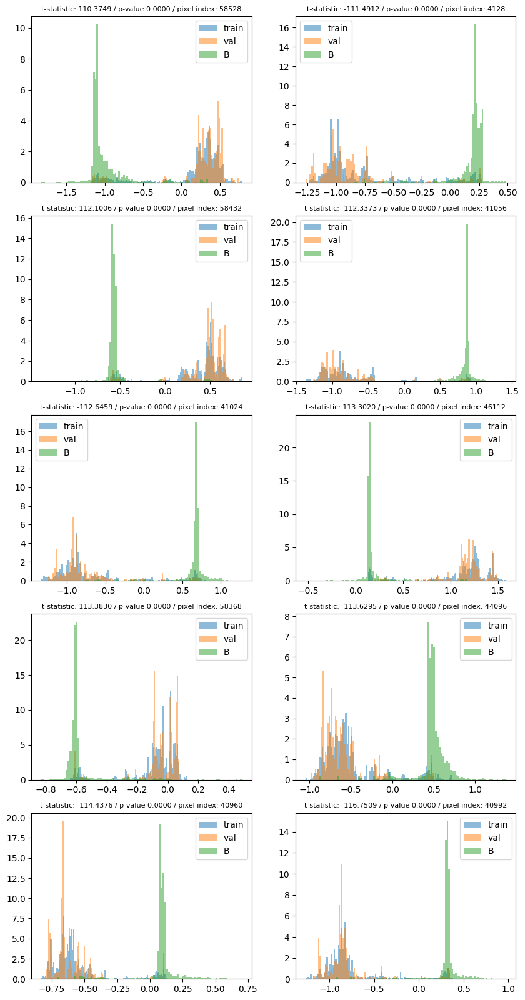

In [32]:
train_subset = act_dict['train'][:, idxs[-10:]]
val_subset = act_dict['val'][:, idxs[-10:]]
B_subset = act_dict['B'][:, idxs[-10:]]
fig, axes = plt.subplots(5, 2, figsize=(10, 20))
kwargs = {
    'bins': 100,
    'alpha': 0.5,
    'density': True,
}

for i, ax in enumerate(axes.flatten()):
    ax.hist(train_subset[:, i], **kwargs, label='train')
    ax.hist(val_subset[:, i], bins=100, alpha=0.5, density=True, label='val')
    ax.hist(B_subset[:, i], bins=100, alpha=0.5, density=True, label='B')
    ax.legend()
    stat = f't-statistic: {statistic[idxs[-10:][i]]:.4f} / ' \
        f'p-value {p_value[idxs[-10:][i]]:.4f} / ' \
        f'pixel index: {idxs[-10:][i]}'
    ax.set_title(stat, fontsize=8)

fig.savefig(f'figures/activations/act-hist_t-test_train-val-B.png', bbox_inches='tight')

In [27]:
kwargs = {
    'bins': 100,
    'alpha': 0.5,
    'density': True,
}

(1504, 10)

In [68]:
torch.cumprod(torch.tensor(acts['down1.3.conv_path.0.bn'].shape[1:]), dim=0)[-1] / 64

tensor(4096.)

In [69]:
acts['down1.3.conv_path.0.bn'].flatten(1,3).shape

torch.Size([1504, 262144])

In [55]:
layer = 'up3.0.conv_path.0.bn'

# X = acts[layer].flatten(1,3).numpy()
# statistic, p_value = normaltest(X, axis=0)

# # sort in ascending order
# idxs = np.argsort(statistic)
# # subset the data for feasible plotting
# X_subset = X[:, idxs[::1000]]

# fig, axes = plt.subplots(33, 2, figsize=(10, 100))
# for i, ax in enumerate(axes.flatten()):
#     ax.hist(X_subset[:, i], bins=100)
#     stat = f'statistic: {statistic[idxs[::1000][i]]:.4f} / p-value {p_value[idxs[::1000][i]]:.4f} / pixel index: {i * 1000}'
#     ax.set_title(stat, fontsize=8)

fig.savefig(f'figures/act-hist_{layer}.png', bbox_inches='tight')


In [33]:
66 /2

33.0

In [23]:
statistic[idxs[:10]]

array([0.00080528, 0.00414988, 0.00442866, 0.00445029, 0.00500928,
       0.00509998, 0.00835504, 0.00946371, 0.01041998, 0.01094942],
      dtype=float32)

In [24]:
statistic[idxs[-10:]]

array([22302.092, 23235.662, 24762.605, 27863.346, 30984.332, 31965.107,
       33805.203, 36023.152, 46474.34 , 54519.75 ], dtype=float32)

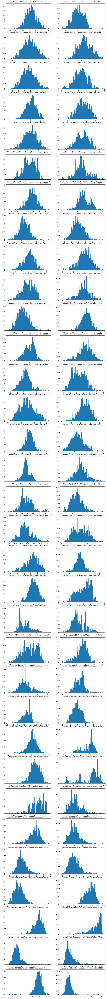

In [48]:
fig, axes = plt.subplots(33, 2, figsize=(10, 100))
for i, ax in enumerate(axes.flatten()):
    ax.hist(X_subset[:, i], bins=100)
    stat = f'statistic: {statistic[idxs[::1000][i]]:.4f} / p-value {p_value[idxs[::1000][i]]:.4f} / pixel index: {i * 1000}'
    ax.set_title(stat, fontsize=8)


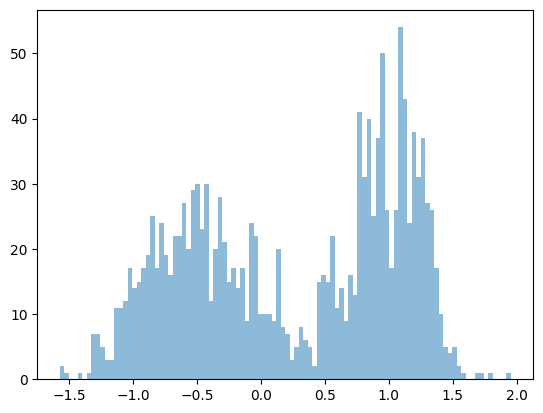

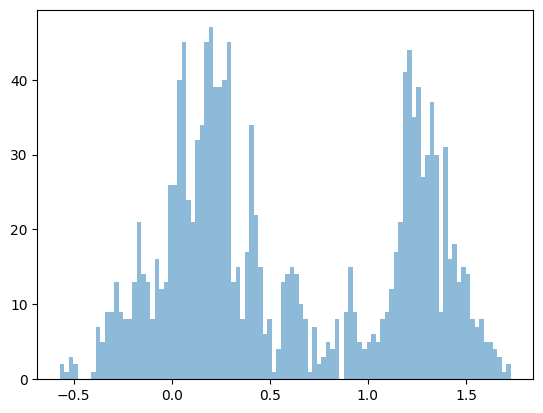

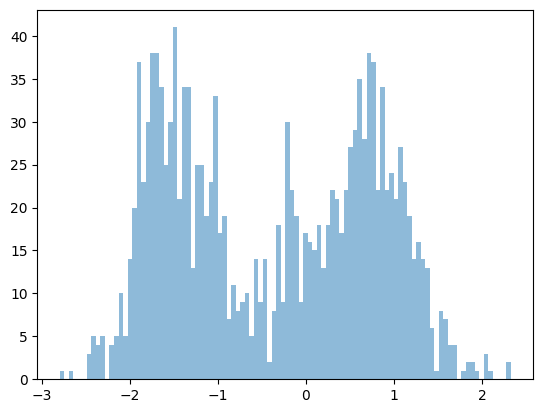

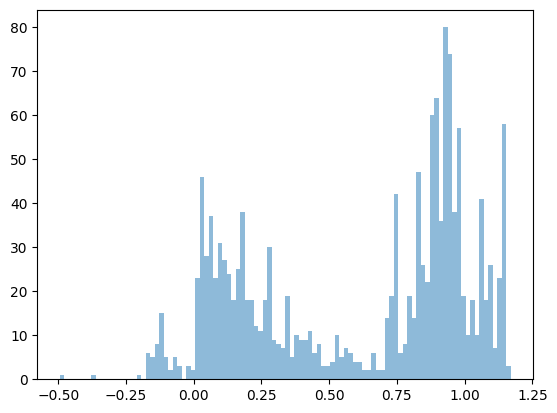

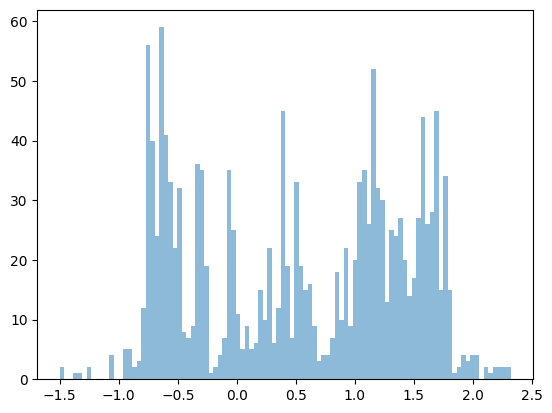

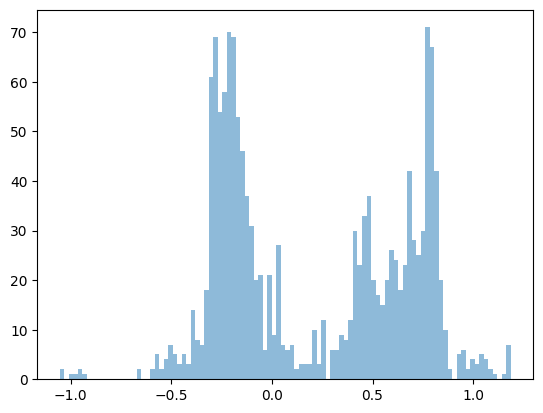

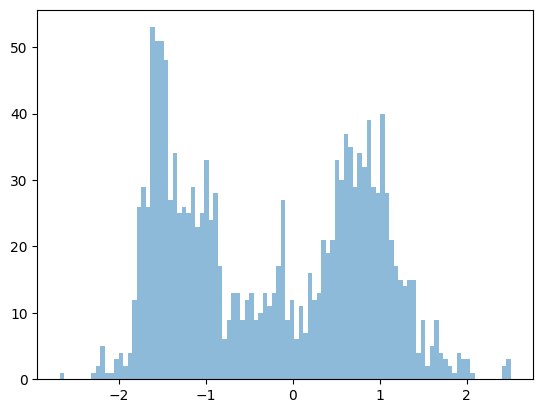

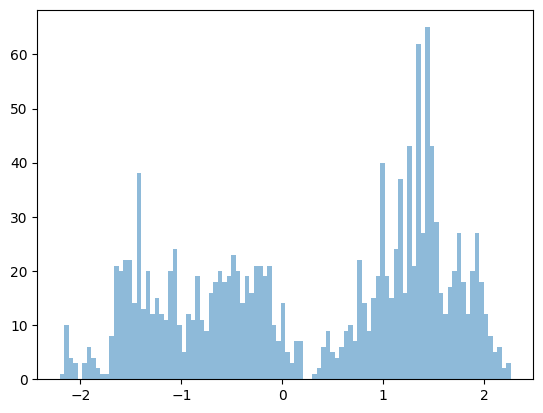

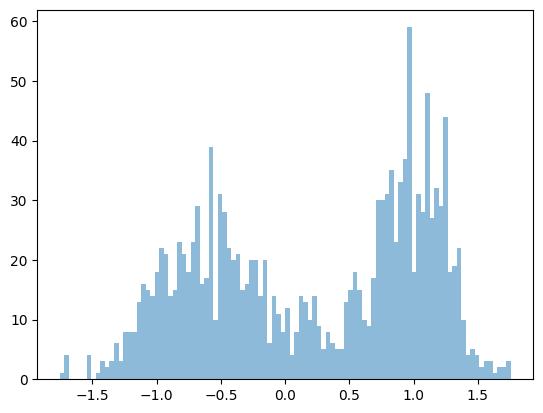

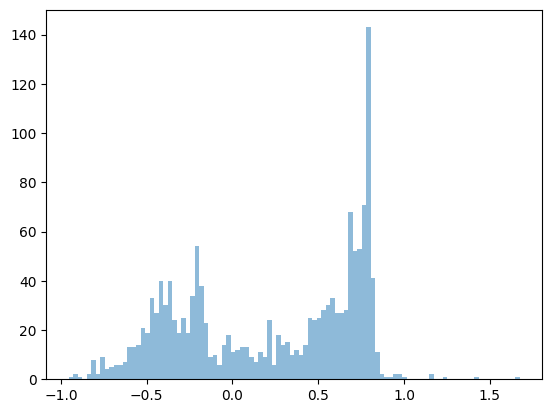

In [28]:
for x in X_yes.T:
    plt.hist(x=x, bins=100, alpha=0.5)
    plt.show()


(array([  1.,   0.,   0.,   0.,   2.,   1.,   2.,   7.,  12.,  22.,  22.,
         43.,  44.,  86., 100., 124., 125., 130., 140., 141., 106.,  86.,
         82.,  77.,  51.,  40.,  24.,  18.,  10.,   6.,   1.,   1.]),
 array([-3.31863928, -3.11865807, -2.91867685, -2.71869564, -2.51871443,
        -2.31873322, -2.118752  , -1.91877079, -1.71878958, -1.51880825,
        -1.31882703, -1.11884582, -0.91886461, -0.7188834 , -0.51890218,
        -0.31892097, -0.11893976,  0.08104146,  0.28102267,  0.48100391,
         0.68098509,  0.88096637,  1.08094752,  1.28092873,  1.48091006,
         1.68089128,  1.88087249,  2.0808537 ,  2.28083491,  2.48081613,
         2.68079734,  2.88077855,  3.08075976]),
 <BarContainer object of 32 artists>)

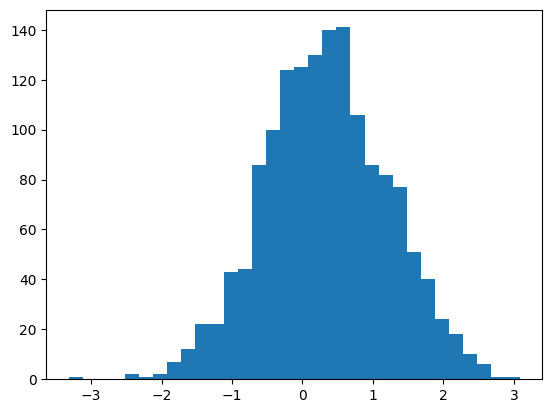

In [149]:
plt.hist(X_yes.flatten(), bins=32)

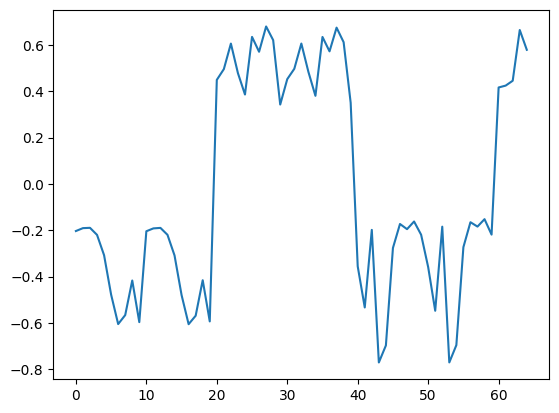

In [144]:
plt.plot(X_yes[:65])

In [80]:
X_yes[:, 0].shape

(1504,)